# Pet Project For Stock Portfolio Analysis (Efficient Frontier)

In [3]:
import matplotlib.pyplot as plt
import pandas as pd
import datetime as dt
import numpy as np
!pip install seaborn yfinance
import yfinance as yfin
import seaborn as sns
import plotly.express as px


In [4]:
# Define a function that performs interactive data visualization using Plotly Express
def plot_financial_data(df, title1):
    
    fig = px.line(title = title1)
    
    # For loop that plots all stock prices in the pandas dataframe df
    # Note that index starts with 1 because we want to skip the date column
    for i in df.columns[1:]:
        fig.add_scatter(x = df['Date'], y = df[i], name = i)
        fig.update_traces(line_width = 5)
        fig.update_layout({'plot_bgcolor': "white"})



    fig.show()

In [5]:
# Select the start/end dates and ticker symbols
tickers = ['AMZN', 'JPM', 'META', 'PG', 'GOOGL', 'CAT', 'PFE', 'EXC', 'DE', 'JNJ']

# Indicate the start and end dates
start = dt.datetime(2014, 1, 1)
end = dt.datetime.now()

# Fetch the stock data
df = yfin.download(tickers, start=start, end=end)

# Select only the 'Adj Close' column
adj_close_df = df['Adj Close']


# Print the adjusted close prices dataframe
print(adj_close_df)

# Save the adjusted close prices to a CSV file
adj_close_df.to_csv('stock_data_adj_close.csv')

[*********************100%***********************]  10 of 10 completed


Ticker                           AMZN         CAT          DE        EXC  \
Date                                                                       
2014-01-02 00:00:00+00:00   19.898500   67.042763   73.582970  13.216288   
2014-01-03 00:00:00+00:00   19.822001   67.005455   73.909065  12.948747   
2014-01-06 00:00:00+00:00   19.681499   66.125183   73.297638  13.031442   
2014-01-07 00:00:00+00:00   19.901501   66.341530   73.623741  13.099539   
2014-01-08 00:00:00+00:00   20.096001   66.498184   72.832939  13.070357   
...                               ...         ...         ...        ...   
2024-10-17 00:00:00+00:00  187.529999  393.077728  405.140015  40.770000   
2024-10-18 00:00:00+00:00  188.990005  392.449982  408.730011  40.950001   
2024-10-21 00:00:00+00:00  189.070007  390.480011  406.959991  40.500000   
2024-10-22 00:00:00+00:00  189.699997  388.459991  406.649994  40.529999   
2024-10-23 00:00:00+00:00  184.710007  385.730011  408.640015  40.740002   

Ticker     

In [6]:
close_price_df = pd.read_csv('stock_data_adj_close.csv')
close_price_df['Date'] = pd.to_datetime(close_price_df['Date']).dt.strftime('%Y-%m-%d')
close_price_df


,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,2014-01-02,19.898500,67.042763,73.582970,13.216288,27.787050,67.750648,43.285355,54.545769,19.114641,58.940643
1,2014-01-03,19.822001,67.005455,73.909065,12.948747,27.584349,68.360954,43.619987,54.396221,19.152292,58.874767
2,2014-01-06,19.681499,66.125183,73.297638,13.031442,27.891897,68.718201,43.872807,57.028294,19.171114,59.013813
3,2014-01-07,19.901501,66.341530,73.623741,13.099539,28.429604,70.176987,43.367161,57.746132,19.290346,59.584637
4,2014-01-08,20.096001,66.498184,72.832939,13.070357,28.488766,70.080223,43.776127,58.055199,19.422131,58.721081
...,...,...,...,...,...,...,...,...,...,...,...
2716,2024-10-17,187.529999,393.077728,405.140015,40.770000,162.929993,164.470001,224.419998,576.929993,29.270000,171.272995
2717,2024-10-18,188.990005,392.449982,408.730011,40.950001,163.419998,165.119995,225.369995,576.469971,29.219999,171.279999
2718,2024-10-21,189.070007,390.480011,406.959991,40.500000,164.070007,162.830002,223.000000,575.159973,28.930000,169.539993
2719,2024-10-22,189.699997,388.459991,406.649994,40.529999,165.139999,163.449997,224.119995,582.010010,28.840000,169.699997


In [7]:
# The objective of this code cell is to calculate the percentage daily return
# We will perform this calculation on all stocks except for the first column which is "Date"
daily_returns_df = close_price_df.iloc[:, 1:].pct_change() * 100
daily_returns_df.replace(np.nan, 0, inplace = True)
daily_returns_df

,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,-0.384451,-0.055648,0.443167,-2.024327,-0.729482,0.900812,0.773086,-0.274169,0.196975,-0.111767
2,-0.708814,-1.313732,-0.827270,0.638633,1.114938,0.522588,0.579595,4.838705,0.098274,0.236172
3,1.117807,0.327178,0.444903,0.522560,1.927823,2.122852,-1.152527,1.258741,0.621937,0.967271
4,0.977313,0.236133,-1.074113,-0.222767,0.208100,-0.137885,0.943032,0.535216,0.683163,-1.449293
...,...,...,...,...,...,...,...,...,...,...
2716,0.342447,0.221025,-1.033290,-0.488164,-1.350212,0.115658,0.348774,0.024275,-1.348162,-0.058018
2717,0.778546,-0.159700,0.886113,0.441502,0.300746,0.395205,0.423312,-0.079736,-0.170827,0.004089
2718,0.042331,-0.501967,-0.433053,-1.098903,0.397754,-1.386866,-1.051602,-0.227245,-0.992468,-1.015884
2719,0.333204,-0.517317,-0.076174,0.074071,0.652156,0.380762,0.502240,1.190979,-0.311096,0.094375


In [8]:
# Insert the date column at the start of the Pandas DataFrame (@ index = 0)
daily_returns_df.insert(0, "Date", close_price_df['Date'])
daily_returns_df

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,2014-01-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,2014-01-03,-0.384451,-0.055648,0.443167,-2.024327,-0.729482,0.900812,0.773086,-0.274169,0.196975,-0.111767
2,2014-01-06,-0.708814,-1.313732,-0.827270,0.638633,1.114938,0.522588,0.579595,4.838705,0.098274,0.236172
3,2014-01-07,1.117807,0.327178,0.444903,0.522560,1.927823,2.122852,-1.152527,1.258741,0.621937,0.967271
4,2014-01-08,0.977313,0.236133,-1.074113,-0.222767,0.208100,-0.137885,0.943032,0.535216,0.683163,-1.449293
...,...,...,...,...,...,...,...,...,...,...,...
2716,2024-10-17,0.342447,0.221025,-1.033290,-0.488164,-1.350212,0.115658,0.348774,0.024275,-1.348162,-0.058018
2717,2024-10-18,0.778546,-0.159700,0.886113,0.441502,0.300746,0.395205,0.423312,-0.079736,-0.170827,0.004089
2718,2024-10-21,0.042331,-0.501967,-0.433053,-1.098903,0.397754,-1.386866,-1.051602,-0.227245,-0.992468,-1.015884
2719,2024-10-22,0.333204,-0.517317,-0.076174,0.074071,0.652156,0.380762,0.502240,1.190979,-0.311096,0.094375


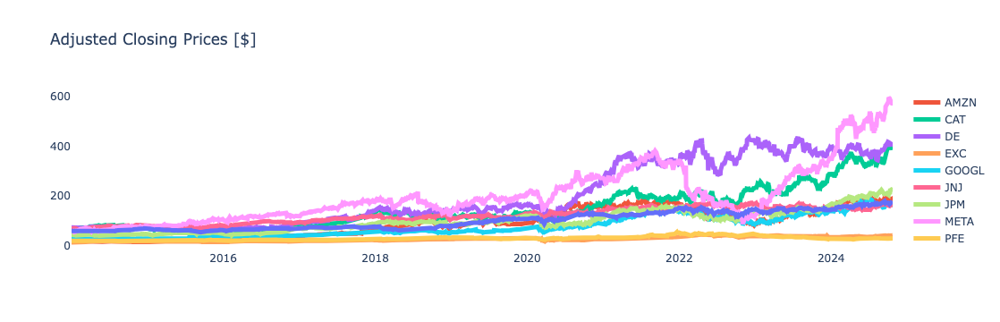

In [11]:
# Plot closing prices using plotly Express. Note that we used the same pre-defined function "plot_financial_data"
plot_financial_data(close_price_df, 'Adjusted Closing Prices [$]')

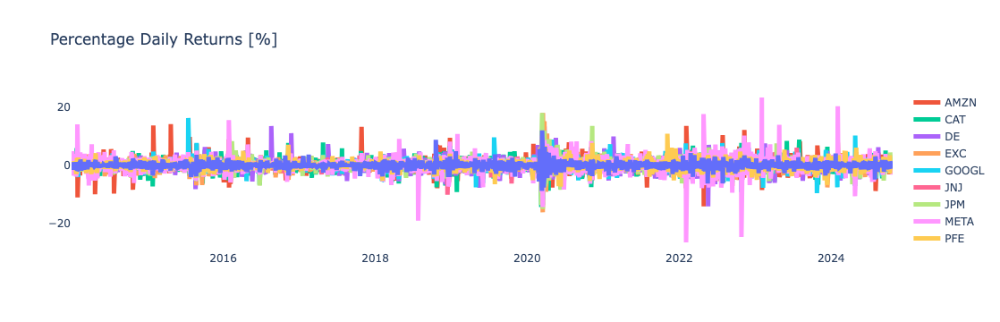

In [12]:
# Plot the stocks daily returns
plot_financial_data(daily_returns_df, 'Percentage Daily Returns [%]')

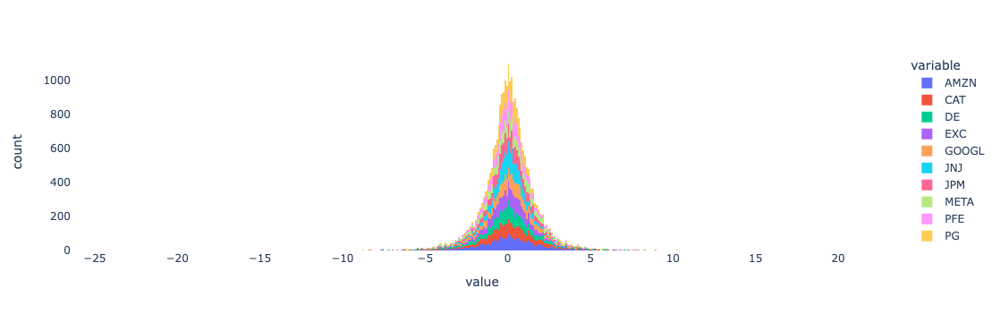

In [13]:
# Plot histograms for stocks daily returns using plotly express
# Compare META to JNJ daily returns histograms
fig = px.histogram(daily_returns_df.drop(columns = ['Date']))
fig.update_layout({'plot_bgcolor': "white"})

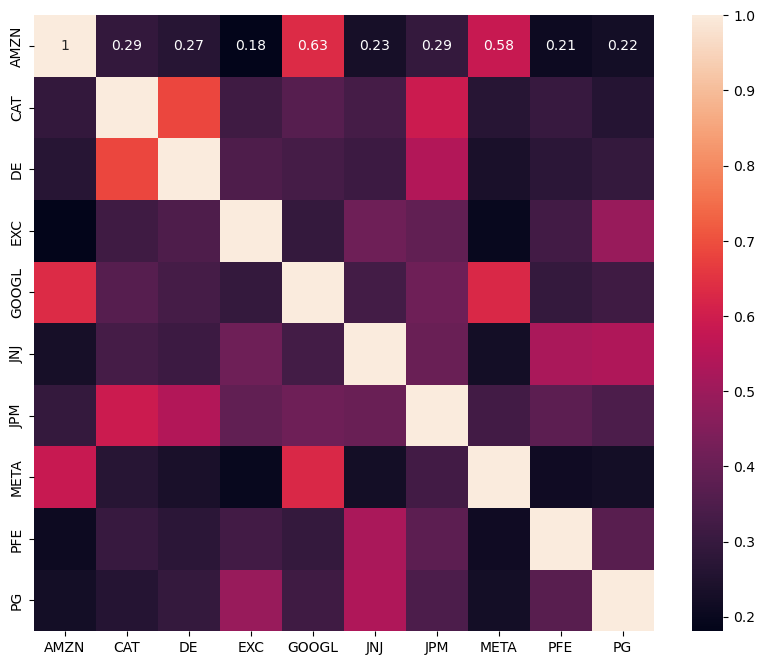

In [18]:
# Plot a heatmap showing the correlations between daily returns
# Strong positive correlations between Catterpillar and John Deere - both into heavy equipment and machinery
# META and Google - both into Tech and Cloud Computing
plt.figure(figsize = (10, 8))
sns.heatmap(daily_returns_df.drop(columns = ['Date']).corr(), annot = True);

In [19]:
# Function to scale stock prices based on their initial starting price
# The objective of this function is to set all prices to start at a value of 1 
def price_scaling(raw_prices_df):
    scaled_prices_df = raw_prices_df.copy()
    for i in raw_prices_df.columns[1:]:
          scaled_prices_df[i] = raw_prices_df[i]/raw_prices_df[i][0]
    return scaled_prices_df

In [21]:
price_scaling(close_price_df)

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,2014-01-02,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2014-01-03,0.996155,0.999444,1.004432,0.979757,0.992705,1.009008,1.007731,0.997258,1.001970,0.998882
2,2014-01-06,0.989095,0.986314,0.996122,0.986014,1.003773,1.014281,1.013572,1.045513,1.002954,1.001241
3,2014-01-07,1.000151,0.989541,1.000554,0.991166,1.023124,1.035813,1.001890,1.058673,1.009192,1.010926
4,2014-01-08,1.009925,0.991877,0.989807,0.988958,1.025253,1.034385,1.011338,1.064339,1.016087,0.996275
...,...,...,...,...,...,...,...,...,...,...,...
2716,2024-10-17,9.424328,5.863090,5.505894,3.084830,5.863522,2.427578,5.184664,10.576989,1.531287,2.905856
2717,2024-10-18,9.497701,5.853726,5.554682,3.098450,5.881157,2.437172,5.206611,10.568555,1.528671,2.905974
2718,2024-10-21,9.501721,5.824342,5.530627,3.064401,5.904549,2.403372,5.151858,10.544539,1.513500,2.876453
2719,2024-10-22,9.533382,5.794212,5.526415,3.066670,5.943056,2.412523,5.177733,10.670122,1.508791,2.879168


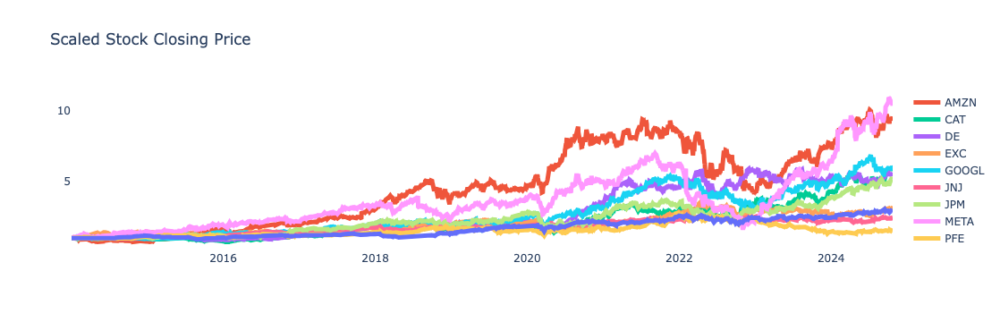

In [24]:
plot_financial_data(price_scaling(close_price_df),"Scaled Stock Closing Price")

In [182]:
# Let's create an array that holds random portfolio weights
# Note that portfolio weights must add up to 1 
import random

def generate_portfolio_weights(n):
    weights = []
    for i in range(n):
        weights.append(random.random())
        
    # let's make the sum of all weights add up to 1
    weights = weights/np.sum(weights)
    return weights

In [184]:
generate_portfolio_weights(5)
print(generate_portfolio_weights(5))
print(generate_portfolio_weights(5).sum())

[0.08595101 0.07201785 0.2463704  0.04282927 0.55283148]
1.0


In [186]:
# Scale stock prices using the "price_scaling" function that we defined earlier (make all stock values start at 1)
portfolio_df = close_price_df.copy()
scaled_df = price_scaling(portfolio_df)
scaled_df

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG
0,2014-01-02,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2014-01-03,0.996155,0.999444,1.004432,0.979757,0.992705,1.009008,1.007731,0.997258,1.001970,0.998882
2,2014-01-06,0.989095,0.986314,0.996122,0.986014,1.003773,1.014281,1.013572,1.045513,1.002954,1.001241
3,2014-01-07,1.000151,0.989541,1.000554,0.991166,1.023124,1.035813,1.001890,1.058673,1.009192,1.010926
4,2014-01-08,1.009925,0.991877,0.989807,0.988958,1.025253,1.034385,1.011338,1.064339,1.016087,0.996275
...,...,...,...,...,...,...,...,...,...,...,...
2716,2024-10-17,9.424328,5.863090,5.505894,3.084830,5.863522,2.427578,5.184664,10.576989,1.531287,2.905856
2717,2024-10-18,9.497701,5.853726,5.554682,3.098450,5.881157,2.437172,5.206611,10.568555,1.528671,2.905974
2718,2024-10-21,9.501721,5.824342,5.530627,3.064401,5.904549,2.403372,5.151858,10.544539,1.513500,2.876453
2719,2024-10-22,9.533382,5.794212,5.526415,3.066670,5.943056,2.412523,5.177733,10.670122,1.508791,2.879168


In [189]:
def asset_allocation(df, weights, initial_investment):
    portfolio_df = df.copy()

    # Scale stock prices using the "price_scaling" function that we defined earlier (Make them all start at 1)
    scaled_df = price_scaling(df)

    # Use enumerate() method to obtain the stock names along with a counter "i" (0, 1, 2, 3,..etc.)
    # This counter "i" will be used as an index to access elements in the "weights" list
    for i, stock in enumerate(scaled_df.columns[1:]):
        portfolio_df[stock] = scaled_df[stock] * weights[i] * initial_investment

    # Sum up all values and place the result in a new column titled "portfolio value [$]" 
    # Note that we excluded the date column from this calculation
    portfolio_df['Portfolio Value [$]'] = portfolio_df[portfolio_df != 'Date'].sum(axis = 1, numeric_only = True)
            
        # Calculate the portfolio percentage daily return and replace NaNs with zeros
    portfolio_df['Portfolio Daily Return [%]'] = portfolio_df['Portfolio Value [$]'].pct_change(1) * 100 
    portfolio_df.replace(np.nan, 0, inplace = True)
    
    return portfolio_df

In [191]:
n = len(close_price_df.columns)-1

print('Number of stocks under consideration = {}'.format(n))
weights = generate_portfolio_weights(n)
print('Portfolio weights = {}'.format(weights))

new_Portfolio_df = asset_allocation(close_price_df, weights, 1000000)
new_Portfolio_df.round(2)

Number of stocks under consideration = 10
Portfolio weights = [0.12033445 0.08772623 0.08978345 0.10546814 0.09464582 0.03337509
 0.15256868 0.17442693 0.13607568 0.00559552]


,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG,Portfolio Value [$],Portfolio Daily Return [%]
0,2014-01-02,120334.45,87726.23,89783.45,105468.14,94645.82,33375.09,152568.68,174426.93,136075.68,5595.52,1000000.00,0.00
1,2014-01-03,119871.82,87677.41,90181.34,103333.12,93955.40,33675.74,153748.17,173948.71,136343.72,5589.26,998324.69,-0.17
2,2014-01-06,119022.15,86525.57,89435.30,103993.04,95002.94,33851.72,154639.28,182365.57,136477.71,5602.46,1006915.76,0.86
3,2014-01-07,120352.59,86808.66,89833.20,104536.47,96834.43,34570.34,152857.03,184661.08,137326.51,5656.66,1013436.97,0.65
4,2014-01-08,121528.81,87013.64,88868.29,104303.59,97035.94,34522.68,154298.52,185649.42,138264.68,5574.67,1017060.25,0.36
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2716,2024-10-17,1134071.32,514346.76,494338.16,325351.29,554957.90,81020.64,791017.28,1844911.72,208370.92,16259.77,5964645.75,-0.15
2717,2024-10-18,1142900.58,513525.35,498718.55,326787.72,556626.92,81340.84,794365.75,1843440.66,208014.96,16260.43,5981981.76,0.29
2718,2024-10-21,1143384.38,510947.62,496558.84,323196.64,558840.92,80212.75,786012.19,1839251.54,205950.48,16095.24,5960450.59,-0.36
2719,2024-10-22,1147194.19,508304.40,496180.59,323436.03,562485.43,80518.17,789959.85,1861156.64,205309.78,16110.43,5990655.52,0.51


In [215]:
new_Portfolio_df = asset_allocation(close_price_df, weights, 1000000)
new_Portfolio_df

,Date,AMZN,CAT,DE,EXC,GOOGL,JNJ,JPM,META,PFE,PG,Portfolio Value [$],Portfolio Daily Return [%]
0,2014-01-02,1.203344e+05,87726.231471,89783.454086,105468.141653,94645.822320,33375.089058,152568.682399,1.744269e+05,136075.683528,5595.517993,1.000000e+06,0.000000
1,2014-01-03,1.198718e+05,87677.413862,90181.344899,103333.121161,93955.397950,33675.735774,153748.169018,1.739487e+05,136343.718588,5589.264068,9.983247e+05,-0.167531
2,2014-01-06,1.190222e+05,86525.567872,89435.301952,103993.040875,95002.942853,33851.721254,154639.284995,1.823656e+05,136477.708962,5602.464345,1.006916e+06,0.860548
3,2014-01-07,1.203526e+05,86808.660088,89833.202074,104536.467012,96834.431320,34570.343350,152857.026150,1.846611e+05,137326.513808,5656.655374,1.013437e+06,0.647642
4,2014-01-08,1.215288e+05,87013.644129,88868.292183,104303.594015,97035.944231,34522.675996,154298.516330,1.856494e+05,138264.677253,5574.673869,1.017060e+06,0.357524
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2716,2024-10-17,1.134071e+06,514346.759573,494338.160977,325351.286943,554957.903058,81020.640537,791017.278930,1.844912e+06,208370.917333,16259.766970,5.964646e+06,-0.149236
2717,2024-10-18,1.142901e+06,513525.345901,498718.553245,326787.718885,556626.916949,81340.838272,794365.750578,1.843441e+06,208014.962971,16260.431873,5.981982e+06,0.290646
2718,2024-10-21,1.143384e+06,510947.616422,496558.835201,323196.639029,558840.921331,80212.749736,786012.185370,1.839252e+06,205950.481987,16095.244805,5.960451e+06,-0.359934
2719,2024-10-22,1.147194e+06,508304.397472,496180.586651,323436.034206,562485.434800,80518.169576,789959.852678,1.861157e+06,205309.777714,16110.434720,5.990656e+06,0.506756


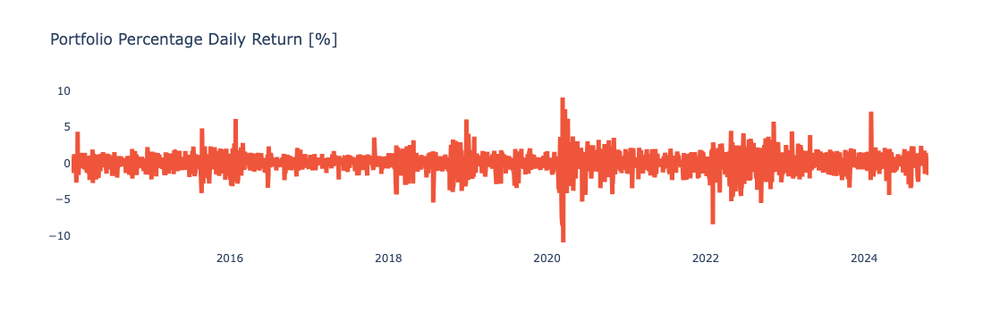

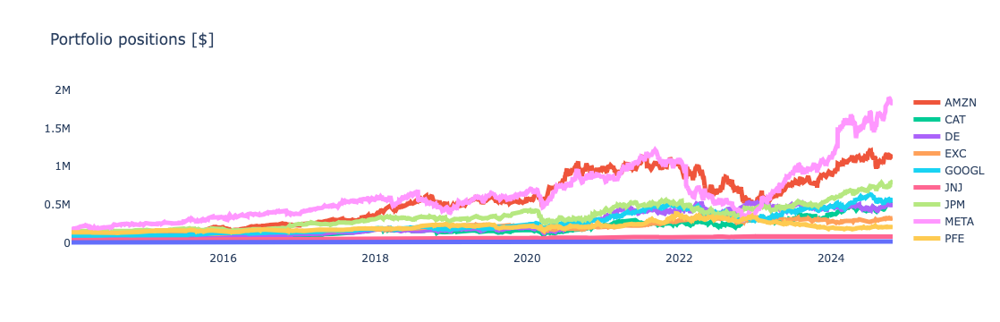

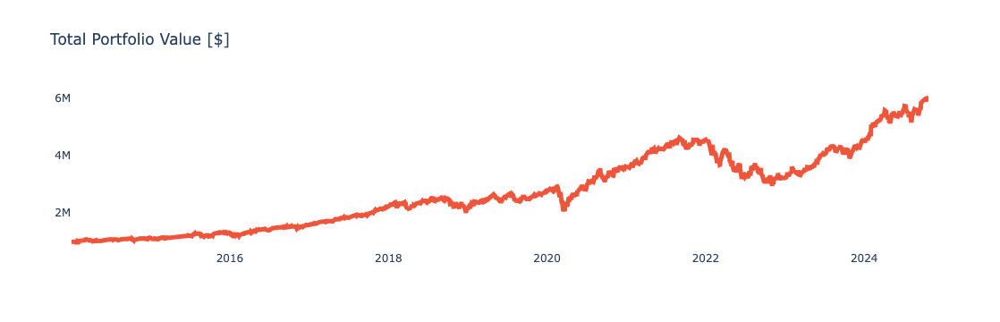

In [193]:
# Plot the portfolio percentage daily return
plot_financial_data(new_Portfolio_df[['Date', 'Portfolio Daily Return [%]']], 'Portfolio Percentage Daily Return [%]')
# Plot each stock position in our portfolio over time
# This graph shows how our initial investment in each individual stock grows over time
plot_financial_data(new_Portfolio_df.drop(['Portfolio Value [$]', 'Portfolio Daily Return [%]'], axis = 1),'Portfolio positions [$]')
# Plot the total daily value of the portfolio (sum of all positions)
plot_financial_data(new_Portfolio_df[['Date', 'Portfolio Value [$]']], 'Total Portfolio Value [$]')

In [311]:
# Define the simulation engine function 
# The function receives: 
    # (1) portfolio weights
    # (2) initial investment amount
# The function performs asset allocation and calculates portfolio statistical metrics including Sharpe ratio
# The function returns: 
    # (1) Expected portfolio return 
    # (2) Expected volatility 
    # (3) Sharpe ratio 
    # (4) Return on investment 
    # (5) Final portfolio value in dollars

def simulation_engine(weights, initial_invesmtnet):
    # perform asset allocation using the random weights (we sent arguments to the function)
    portfolio_df = asset_allocation(close_price_df, weights, initial_invesmtnet)

    # Calculate the return on the investment ( last - intital/ last)
    return_on_investment = ((portfolio_df['Portfolio Value [$]'][-1:] - 
                             portfolio_df['Portfolio Value [$]'][0])/ 
                             portfolio_df['Portfolio Value [$]'][0]) * 100
    
    # Daily change of every stock in the portfolio (Note that we dropped the date, portfolio daily worth and daily % returns) 
    portfolio_daily_return_df = portfolio_df.drop(columns = ['Date', 'Portfolio Value [$]', 'Portfolio Daily Return [%]'])
    portfolio_daily_return_df = portfolio_daily_return_df.pct_change(1) 

    # Portfolio Expected Return formula
    expected_portfolio_return = np.sum(weights * portfolio_daily_return_df.mean() ) * 252


    covariance = portfolio_daily_return_df.cov() *252 
    
    expected_volatility = np.sqrt(np.dot(weights.T, np.dot(covariance, weights)))

    rf = 0.04
    sharpe_ratio = (expected_portfolio_return - rf)/expected_volatility
    
    return expected_portfolio_return, expected_volatility, sharpe_ratio, portfolio_df['Portfolio Value [$]'][-1:].values[0], return_on_investment.values[0]




In [313]:
# Let's test out the "simulation_engine" function and print out statistical metrics
# Define the initial investment amount
initial_investment = 1000000
portfolio_metrics = simulation_engine(weights, initial_investment)

In [317]:
print('Expected Portfolio Annual Return = {:.2f}%'.format(portfolio_metrics[0] * 100))
print('Portfolio Standard Deviation (Volatility) = {:.2f}%'.format(portfolio_metrics[1] * 100))
print('Sharpe Ratio = {:.2f}'.format(portfolio_metrics[2]))
print('Portfolio Final Value = ${:.2f}'.format(portfolio_metrics[3]))
print('Return on Investment = {:.2f}%'.format(portfolio_metrics[4]))


Expected Portfolio Annual Return = 19.17%
Portfolio Standard Deviation (Volatility) = 19.13%
Sharpe Ratio = 0.79
Portfolio Final Value = $5893204.17
Return on Investment = 489.32%


In [327]:
# Set the number of simulation runs
sim_runs = 10000
initial_investment = 1000000

eights_runs = np.zeros((sim_runs, n))
eights_runs

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [399]:
# Set the number of simulation runs
sim_runs = 10000
initial_investment = 1000000

# Placeholder to store all weights
weights_runs = np.zeros((sim_runs, n))

# Placeholder to store all Sharpe ratios
sharpe_ratio_runs = np.zeros(sim_runs)

# Placeholder to store all expected returns
expected_portfolio_returns_runs = np.zeros(sim_runs)

# Placeholder to store all volatility values
volatility_runs = np.zeros(sim_runs)

# Placeholder to store all returns on investment
return_on_investment_runs = np.zeros(sim_runs)

# Placeholder to store all final portfolio values
final_value_runs = np.zeros(sim_runs)

for i in range(sim_runs):
    # Generate random weights 
    weights = generate_portfolio_weights(n)
    # Store the weights
    weights_runs[i,:] = weights
    
    # Call "simulation_engine" function and store Sharpe ratio, return and volatility
    # Note that asset allocation is performed using the "asset_allocation" function  
    expected_portfolio_returns_runs[i], volatility_runs[i], sharpe_ratio_runs[i], final_value_runs[i], return_on_investment_runs[i] = simulation_engine(weights, initial_investment)
    print("Simulation Run = {}".format(i))   
    print("Weights = {}, Final Value = ${:.2f}, Sharpe Ratio = {:.2f}".format(weights_runs[i].round(3), final_value_runs[i], sharpe_ratio_runs[i]))   
    print('\n')

Simulation Run = 0
Weights = [0.046 0.075 0.059 0.15  0.188 0.079 0.109 0.04  0.063 0.192], Final Value = $4564741.15, Sharpe Ratio = 0.74


Simulation Run = 1
Weights = [0.036 0.198 0.191 0.022 0.034 0.086 0.104 0.075 0.055 0.198], Final Value = $4979906.42, Sharpe Ratio = 0.75


Simulation Run = 2
Weights = [0.129 0.136 0.095 0.136 0.116 0.044 0.053 0.059 0.133 0.098], Final Value = $5086126.36, Sharpe Ratio = 0.77


Simulation Run = 3
Weights = [0.191 0.053 0.058 0.012 0.151 0.008 0.153 0.097 0.164 0.113], Final Value = $5701770.53, Sharpe Ratio = 0.77


Simulation Run = 4
Weights = [0.127 0.128 0.001 0.042 0.241 0.183 0.142 0.115 0.018 0.004], Final Value = $5867075.01, Sharpe Ratio = 0.79


Simulation Run = 5
Weights = [0.022 0.186 0.12  0.146 0.152 0.013 0.153 0.014 0.192 0.002], Final Value = $4547524.17, Sharpe Ratio = 0.68


Simulation Run = 6
Weights = [0.02  0.031 0.095 0.158 0.144 0.151 0.103 0.103 0.002 0.194], Final Value = $4746881.04, Sharpe Ratio = 0.76


Simulation Ru

In [401]:
# List all Sharpe ratios generated from the simulation
sharpe_ratio_runs

array([0.74029345, 0.7545333 , 0.76762579, ..., 0.73908168, 0.75880021,
       0.72674499])

In [403]:
# Return the index of the maximum Sharpe ratio (Best simulation run) 
sharpe_ratio_runs.argmax()

4725

In [405]:
# Return the maximum Sharpe ratio value
sharpe_ratio_runs.max()

0.8525677400747305

In [409]:
# Obtain the portfolio weights that correspond to the maximum Sharpe ratio (Golden set of weights!)
weights_runs[sharpe_ratio_runs.argmax(), :]

array([0.19832065, 0.17293256, 0.16447976, 0.08153334, 0.06165949,
       0.00043855, 0.083798  , 0.1448091 , 0.00065764, 0.09137092])

In [411]:
# Return Sharpe ratio, volatility corresponding to the best weights allocation (maximum Sharpe ratio)
optimal_portfolio_return, optimal_volatility, optimal_sharpe_ratio, highest_final_value, optimal_return_on_investment = simulation_engine(weights_runs[sharpe_ratio_runs.argmax(), :], initial_investment)

In [413]:
print('Best Portfolio Metrics Based on {} Monte Carlo Simulation Runs:'.format(sim_runs))
print('  - Portfolio Expected Annual Return = {:.02f}%'.format(optimal_portfolio_return * 100))
print('  - Portfolio Standard Deviation (Volatility) = {:.02f}%'.format(optimal_volatility * 100))
print('  - Sharpe Ratio = {:.02f}'.format(optimal_sharpe_ratio))
print('  - Final Value = ${:.02f}'.format(highest_final_value))
print('  - Return on Investment = {:.02f}%'.format(optimal_return_on_investment))

Best Portfolio Metrics Based on 10000 Monte Carlo Simulation Runs:
  - Portfolio Expected Annual Return = 21.09%
  - Portfolio Standard Deviation (Volatility) = 20.05%
  - Sharpe Ratio = 0.85
  - Final Value = $6555827.59
  - Return on Investment = 555.58%


In [419]:
# Create a DataFrame that contains volatility, return, and Sharpe ratio for all simualation runs
sim_out_df = pd.DataFrame({'Volatility': volatility_runs.tolist(), 'Portfolio_Return': expected_portfolio_returns_runs.tolist(), 'Sharpe_Ratio': sharpe_ratio_runs.tolist() })
sim_out_df

,Volatility,Portfolio_Return,Sharpe_Ratio
0,0.165730,0.162689,0.740293
1,0.176925,0.173496,0.754533
2,0.173265,0.173003,0.767626
3,0.187149,0.184758,0.773492
4,0.193392,0.192962,0.790943
...,...,...,...
9995,0.183574,0.187068,0.801134
9996,0.165485,0.146939,0.646218
9997,0.173989,0.168592,0.739082
9998,0.166429,0.166287,0.758800


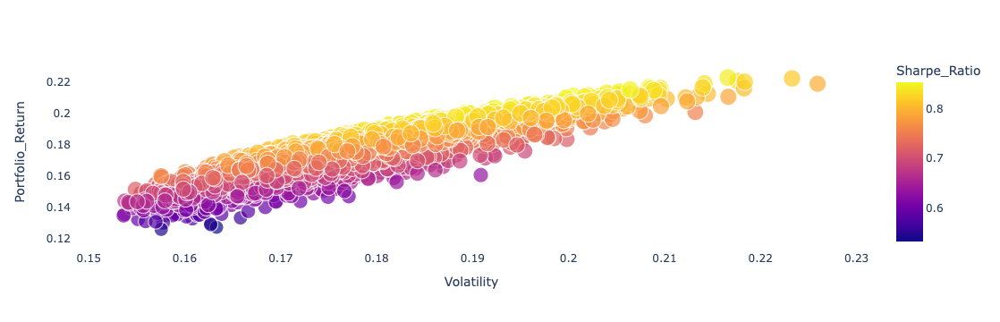

In [421]:
# Plot volatility vs. return for all simulation runs
# Highlight the volatility and return that corresponds to the highest Sharpe ratio
import plotly.graph_objects as go
fig = px.scatter(sim_out_df, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio', size = 'Sharpe_Ratio', hover_data = ['Sharpe_Ratio'] )
fig.update_layout({'plot_bgcolor': "white"})
fig.show()


# Use this code if Sharpe ratio is negative
# fig = px.scatter(sim_out_df, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio', hover_data = ['Sharpe_Ratio'] )


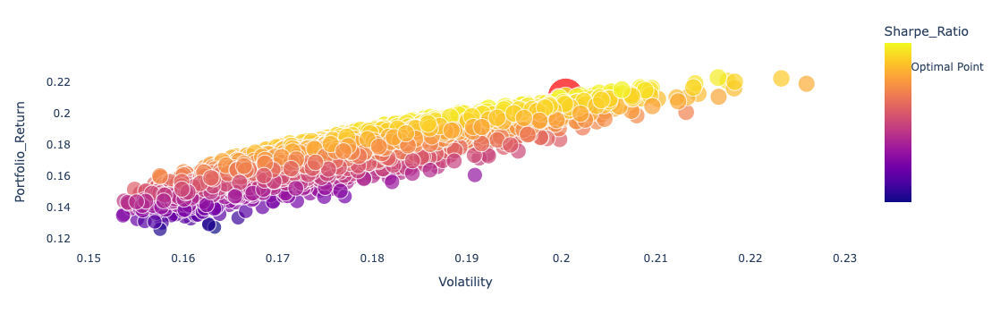

In [423]:
# Let's highlight the point with the highest Sharpe ratio
fig = px.scatter(sim_out_df, x = 'Volatility', y = 'Portfolio_Return', color = 'Sharpe_Ratio', size = 'Sharpe_Ratio', hover_data = ['Sharpe_Ratio'] )
fig.add_trace(go.Scatter(x = [optimal_volatility], y = [optimal_portfolio_return], mode = 'markers', name = 'Optimal Point', marker = dict(size=[40], color = 'red')))
fig.update_layout(coloraxis_colorbar = dict(y = 0.7, dtick = 5))
fig.update_layout({'plot_bgcolor': "white"})
fig.show()